In [ ]:
import glob

from attrdict import AttrDict
from potoo.plot import *
from potoo.util import *
import sklearn

from cache import *
from datasets import *
from features import *
from load import *
from sp14.model import *
from util import *
from viz import *

figsize('inline_short');

In [ ]:
recs_paths = load_recs_paths()
display(
    recs_paths.shape,
    recs_paths.groupby('dataset').head(2),
    recs_paths.dataset.value_counts(),
)

(51664, 2)

,dataset,path
0,recordings,recordings/081845.wav
1,recordings,"recordings/ACWO,NOFL,SPTO spotted towhee, acorn woodpecker, flicker.wav"
98,peterson-field-guide,peterson-field-guide/bewwre/audio/43220301 Song.mp3
99,peterson-field-guide,peterson-field-guide/bewwre/audio/43220321 Song.mp3
439,birdclef-2015,birdclef-2015/organized/wav/00000-2015-amazon.wav
440,birdclef-2015,birdclef-2015/organized/wav/00001-2014-amazon.wav
33642,warblrb10k,dcase-2018/warblrb10k_public_wav/000e088a-69f7-4d7a-ba7b.wav
33643,warblrb10k,dcase-2018/warblrb10k_public_wav/0011e7f9-ec1e-4f3a-a70f.wav
41642,ff1010bird,dcase-2018/ff1010bird_wav/100.wav
41643,ff1010bird,dcase-2018/ff1010bird_wav/100180.wav


birdclef-2015           33203
warblrb10k               8000
ff1010bird               7690
nips4b                   1687
mlsp-2013                 645
peterson-field-guide      341
recordings                 98
Name: dataset, dtype: int64

In [ ]:
recs = load_recs_data(
    (recs_paths
        .groupby('dataset')
        .apply(lambda g: (g
            .pipe(sklearn.utils.shuffle, random_state=0)
            .head({  # For faster dev
                # WARNING: This blew up ram last time
                # 'recordings': 500,
                # 'peterson-field-guide': 500,
                # 'mlsp-2013': 645,
            }.get(g.name, 100))
        ))
        .reset_index(drop=True)
    ),
    # FIXME pickling AudioSegment's across processes makes this (1) slow and (2) super-linearly slow
    #   - TODO We want 'processes' par for converting audio to std .wav format and 'threads' par for loading from std
    #     .wav, so split the convert (metadata_only=True) + load (metadata_only=False) steps to separate these concerns
    # metadata_only=True, dask_opts=dict(scheduler='processes'),
    metadata_only=False, dask_opts=dict(scheduler='threads'),
)
display(
    recs.shape,
    recs.groupby('dataset').head(2),
    recs.dataset.value_counts(),
)

[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[######                                                                                    ] | 6% Completed |  0.2s

[############                                                                              ] | 13% Completed |  0.3s

[###################                                                                       ] | 21% Completed |  0.4s

[########################                                                                  ] | 27% Completed |  0.6s

[#########################                                                                 ] | 28% Completed |  0.9s

[#########################                                                                 ] | 28% Completed |  1.0s

[#########################                                                                 ] | 28% Completed |  1.1s

[#########################                                                                 ] | 28% Completed |  1.3s

[###########################                                                               ] | 30% Completed |  1.4s

[####################################                                                      ] | 41% Completed |  1.5s

[##############################################                                            ] | 51% Completed |  1.6s

[#####################################################                                     ] | 59% Completed |  1.7s

[#############################################################                             ] | 68% Completed |  1.8s

[###############################################################                           ] | 70% Completed |  1.9s

[####################################################################                      ] | 76% Completed |  2.1s

[######################################################################                    ] | 77% Completed |  2.2s

[############################################################################              ] | 84% Completed |  2.3s

[###################################################################################       ] | 92% Completed |  2.4s

[##########################################################################################] | 100% Completed |  2.6s

(698, 10)

,dataset,species,species_query,basename,name,duration_s,samples_mb,samples_n,samples,audio
0,birdclef-2015,XXXX,None,02358-2014-amazon,birdclef-2015/organized/wav/02358-2014-amazon,6.04,0.254,133182,[ -458 -2425 -2445 ... 40 20 -8],"birdclef-2015/organized/wav/02358-2014-amazon: 1 channels, 16 bit, sampled @ 22.05 kHz, 6.040s long"
1,birdclef-2015,XXXX,None,00628-2014-amazon,birdclef-2015/organized/wav/00628-2014-amazon,18.10,0.760,398314,[-1256 -396 -557 ... 989 -630 -3013],"birdclef-2015/organized/wav/00628-2014-amazon: 1 channels, 16 bit, sampled @ 22.05 kHz, 18.064s long"
100,ff1010bird,XXXX,None,184277,dcase-2018/ff1010bird_wav/184277,10.00,0.421,220500,[ 2303 4730 3501 ... -6064 -3920 -2909],"dcase-2018/ff1010bird_wav/184277: 1 channels, 16 bit, sampled @ 22.05 kHz, 10.000s long"
101,ff1010bird,XXXX,None,191743,dcase-2018/ff1010bird_wav/191743,10.00,0.421,220500,[-179 261 858 ... -121 -865 -277],"dcase-2018/ff1010bird_wav/191743: 1 channels, 16 bit, sampled @ 22.05 kHz, 10.000s long"
200,mlsp-2013,XXXX,None,PC1_20090513_070000_0040,mlsp-2013/mlsp_contest_dataset/essential_data/src_wavs/PC1_20090513_070000_0040,10.00,0.421,220500,[131 157 99 ... 123 -25 -70],"mlsp-2013/mlsp_contest_dataset/essential_data/src_wavs/PC1_20090513_070000_0040: 1 channels, 16 bit, sampled @ 22.05 kHz, 10.000s long"
201,mlsp-2013,CONI,None,PC5_20090804_050000_0040,mlsp-2013/mlsp_contest_dataset/essential_data/src_wavs/PC5_20090804_050000_0040,10.00,0.421,220500,[130 118 85 ... -33 -56 -36],"mlsp-2013/mlsp_contest_dataset/essential_data/src_wavs/PC5_20090804_050000_0040: 1 channels, 16 bit, sampled @ 22.05 kHz, 10.000s long"
300,nips4b,XXXX,None,nips4b_birds_testfile0035,nips4b/all_wav/nips4b_birds_testfile0035,5.00,0.210,110336,[ -62 19 7 ... -208 -254 -90],"nips4b/all_wav/nips4b_birds_testfile0035: 1 channels, 16 bit, sampled @ 22.05 kHz, 5.004s long"
301,nips4b,XXXX,None,nips4b_birds_testfile0741,nips4b/all_wav/nips4b_birds_testfile0741,5.00,0.210,110336,[-17 4 14 ... 6 5 -1],"nips4b/all_wav/nips4b_birds_testfile0741: 1 channels, 16 bit, sampled @ 22.05 kHz, 5.004s long"
400,peterson-field-guide,BUSH,bushti,43218231 Dzit & Dzit Series,peterson-field-guide/bushti/audio/43218231 Dzit & Dzit Series,14.20,0.595,312192,[0 0 0 ... 0 1 0],"peterson-field-guide/bushti/audio/43218231 Dzit & Dzit Series: 1 channels, 16 bit, sampled @ 22.05 kHz, 14.158s long"
401,peterson-field-guide,CANW,canwre,43219311 Female Song,peterson-field-guide/canwre/audio/43219311 Female Song,3.55,0.149,78336,[0 0 0 ... 0 1 0],"peterson-field-guide/canwre/audio/43219311 Female Song: 1 channels, 16 bit, sampled @ 22.05 kHz, 3.553s long"


peterson-field-guide    100
ff1010bird              100
birdclef-2015           100
warblrb10k              100
nips4b                  100
mlsp-2013               100
recordings               98
Name: dataset, dtype: int64

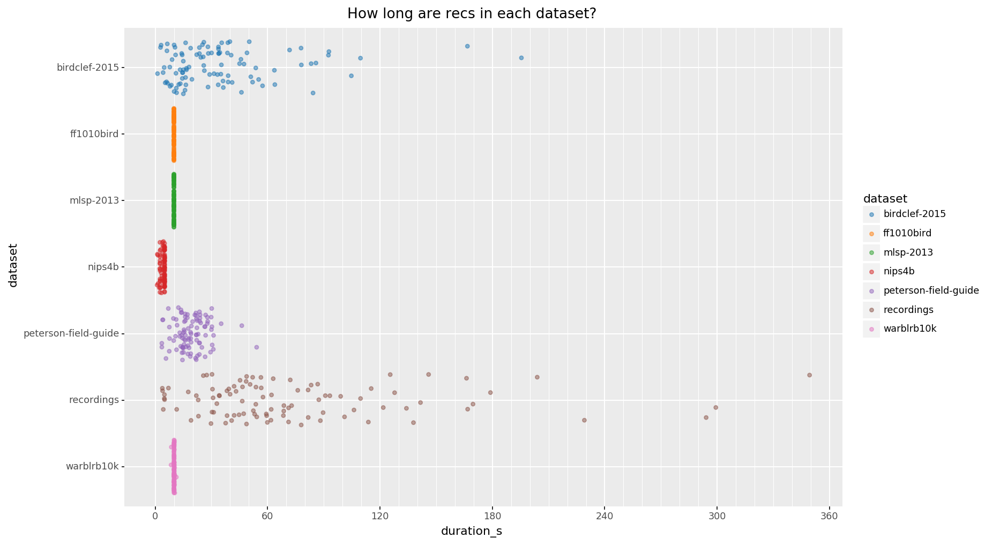

<ggplot: (-9223372035887684934)>

In [ ]:
(recs
    .pipe(ggplot)
    + geom_jitter(aes(x='duration_s', y='dataset', color='dataset'), alpha=.5)
    + scale_y_discrete(limits=list(reversed(recs.dataset.unique())))
    + scale_color_cmap_d(mpl.cm.tab10)
    + scale_x_continuous(
        breaks=lambda lims: np.arange((lims[0] // 60 + 1) * 60, lims[1], 60),
        minor_breaks=lambda lims: np.arange((lims[0] // 60 + 1) * 60, lims[1], 10),
    )
    + theme_figsize('inline')
    + ggtitle('How long are recs in each dataset?')
)

In [ ]:
# Compute spectros
model = Model(verbose_config=False)
recs['spectro'] = model.spectros(recs)

[Memory]19.6s, 0.3min   : Loading _spectros_cache_block from /Users/danb/hack/bubo/data/cache/joblib/sp14/model/_spectros_cache_block/0f0521a3d81a16439a1e066d70f378c1


________________________________spectros_cache_block cache loaded - 0.7s, 0.0min
[Memory]20.4s, 0.3min   : Loading _spectros_cache_block from /Users/danb/hack/bubo/data/cache/joblib/sp14/model/_spectros_cache_block/d13bbdfd277e72066875f90bff22d9d2


________________________________spectros_cache_block cache loaded - 0.2s, 0.0min
[Memory]20.9s, 0.3min   : Loading _spectros_cache_block from /Users/danb/hack/bubo/data/cache/joblib/sp14/model/_spectros_cache_block/3e82b153cd94df0f698869527d0567a1


________________________________spectros_cache_block cache loaded - 0.2s, 0.0min
[Memory]21.2s, 0.4min   : Loading _spectros_cache_block from /Users/danb/hack/bubo/data/cache/joblib/sp14/model/_spectros_cache_block/6e2671eebafebf8a3b38466c74ce09b9


________________________________spectros_cache_block cache loaded - 0.1s, 0.0min


[Memory]21.7s, 0.4min   : Loading _spectros_cache_block from /Users/danb/hack/bubo/data/cache/joblib/sp14/model/_spectros_cache_block/b67b036f9c83da7d091247308b882064


________________________________spectros_cache_block cache loaded - 0.4s, 0.0min


[Memory]23.3s, 0.4min   : Loading _spectros_cache_block from /Users/danb/hack/bubo/data/cache/joblib/sp14/model/_spectros_cache_block/f44521bf52b7f254cf4a711815a288d1


________________________________spectros_cache_block cache loaded - 1.0s, 0.0min
[Memory]24.4s, 0.4min   : Loading _spectros_cache_block from /Users/danb/hack/bubo/data/cache/joblib/sp14/model/_spectros_cache_block/86f5b3b10bfda99eedccd438fbffe016


________________________________spectros_cache_block cache loaded - 0.2s, 0.0min


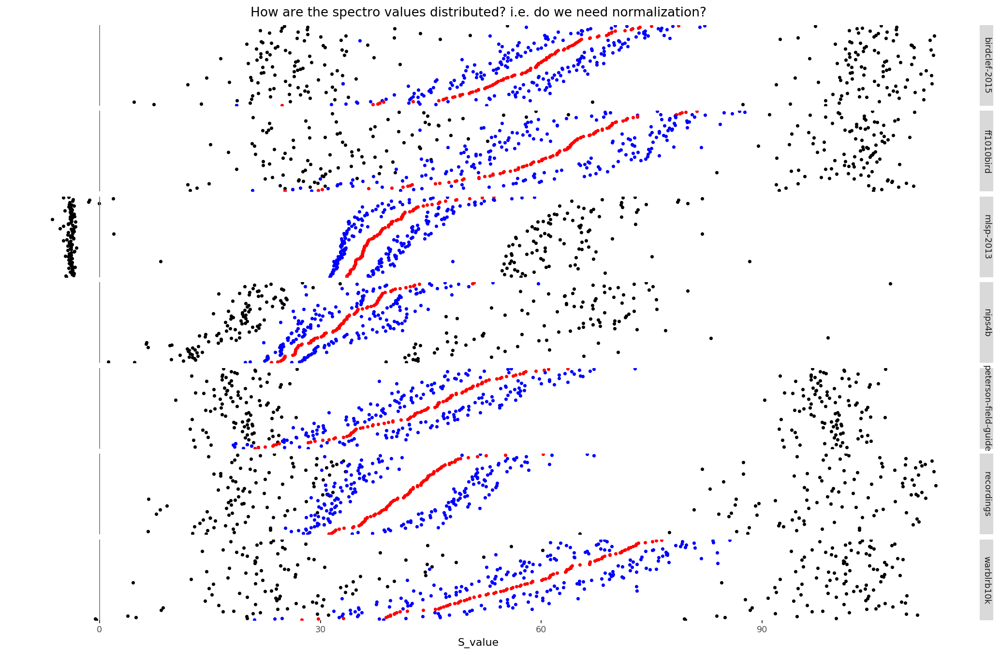

CPU times: user 46.1 s, sys: 11.8 s, total: 58 s
Wall time: 25 s


'<ggplot: (-9223372036509474581)>'

In [ ]:
%%time
repr(recs
    # [lambda df: df.dataset.isin(['recordings', 'peterson-field-guide'])]
    .groupby('dataset').apply(lambda g: (g
        .pipe(sklearn.utils.shuffle, random_state=0)
        # .head(2)  # 2s
        # .head(12)  # 4s
        # .head(25)  # 7s
        # .head(50)  # 12s
        # .head(100)  # 25s
        .head(None)  # 25s
    ))
    .assign(S_values=lambda df: df.spectro.map(lambda spectro: spectro.S.flatten()))
    .assign(S_min=lambda df: df.S_values.map(lambda S_values: S_values.min()))
    .assign(S_max=lambda df: df.S_values.map(lambda S_values: S_values.max()))
    .assign(S_25p=lambda df: df.S_values.map(lambda S_values: np.percentile(S_values, 25)))
    .assign(S_50p=lambda df: df.S_values.map(lambda S_values: np.percentile(S_values, 50)))
    .assign(S_75p=lambda df: df.S_values.map(lambda S_values: np.percentile(S_values, 75)))
    .assign(y=lambda df: df.basename.str.slice(0, 30))
    # Categorical types + facets show all cat values across all facets, which isn't what I want here (but maybe somewhere else)
    # .assign(y=lambda df: df.y.astype(pd.api.types.CategoricalDtype(categories=df.sort_values('S_50p').y.unique(), ordered=True)))
    # Instead, hack the y labels to string sort
    .assign(y=lambda df: df.apply(axis=1, func=lambda row: '[%020.6f] %s' % (row.S_50p, row.y)))
    .pipe(ggplot, aes(y='y'))
    + geom_point(aes(x='S_min'), shape='.', size=1, stroke=1, color='black')
    + geom_point(aes(x='S_25p'), shape='.', size=1, stroke=1, color='blue')
    + geom_point(aes(x='S_50p'), shape='.', size=1, stroke=1, color='red')
    + geom_point(aes(x='S_75p'), shape='.', size=1, stroke=1, color='blue')
    + geom_point(aes(x='S_max'), shape='.', size=1, stroke=1, color='black')
    + facet_grid('dataset ~ .', scales='free_y')
    + geom_vline(xintercept=0, color='gray')
    + xlab('S_value')
    + ylab('')
    + theme(axis_text_y=element_blank())
    + theme(axis_ticks_major_y=element_blank())
    # + theme_figsize(aspect_ratio=1/8)
    + theme_figsize(width=18, aspect_ratio=2/3/8)
    # + theme_figsize(width=24, aspect_ratio=2/3/8)
    + ggtitle('How are the spectro values distributed? i.e. do we need normalization?')
)

In [ ]:
# Vis lots of spectros per dataset [XXX Slow, and not great output. Prefer the big np.concatenate approach.]
# %%time
# # figsize(width=24, aspect_ratio=1/16)
# # figsize(width=24, aspect_ratio=1)
# figsize('inline_short')
# # figsize('inline')
# # figsize('square')
# # figsize('full')
# # figsize('full_dense')
# # cols, rows_per_dataset = 6, 2
# cols, rows_per_dataset = 2, 1
# spectros_df = recs.groupby('dataset').head(cols * rows_per_dataset)
# n_spectros = len(spectros_df)
# for i, row in spectros_df.reset_index(drop=True).iterrows():
#     plt.subplot(int(np.ceil(n_spectros / cols)), cols, i + 1)
#     row.spectro.plot(show_audio=False, fancy=False)
#     plt.ylabel(row.dataset, fontsize='x-small')
# plt.show()

In [ ]:
recs.dataset.value_counts()

peterson-field-guide    100
ff1010bird              100
birdclef-2015           100
warblrb10k              100
nips4b                  100
mlsp-2013               100
recordings               98
Name: dataset, dtype: int64

(4100, 5168)

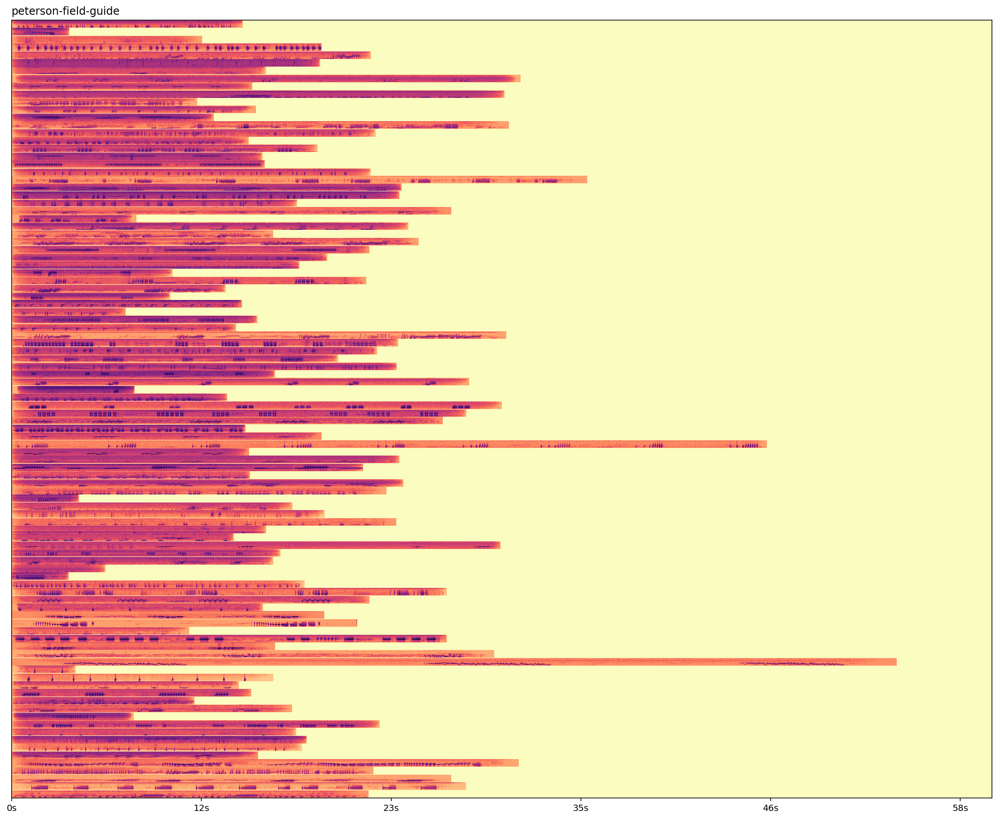

In [ ]:
with with_figsize('full'):
    plot_many_spectros(recs, "dataset == 'peterson-field-guide'")

(4100, 5168)

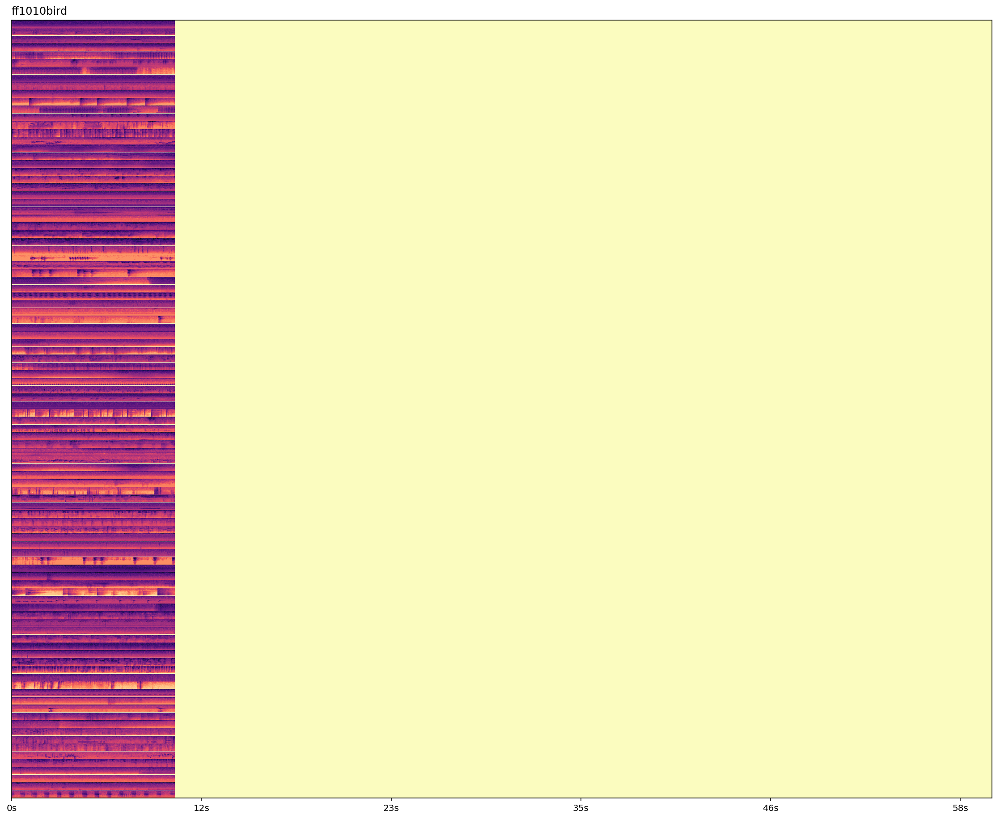

In [ ]:
with with_figsize('full'):
    plot_many_spectros(recs, "dataset == 'ff1010bird'")

(4100, 5168)

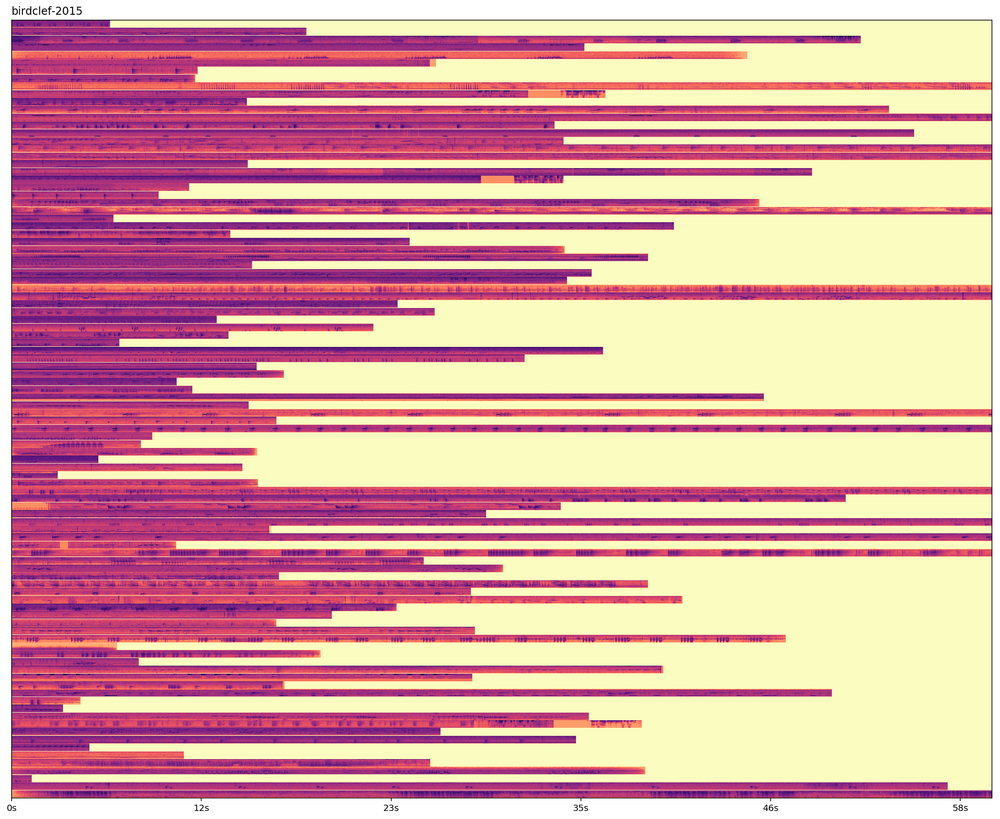

In [ ]:
with with_figsize('full'):
    plot_many_spectros(recs, "dataset == 'birdclef-2015'")

(4100, 5168)

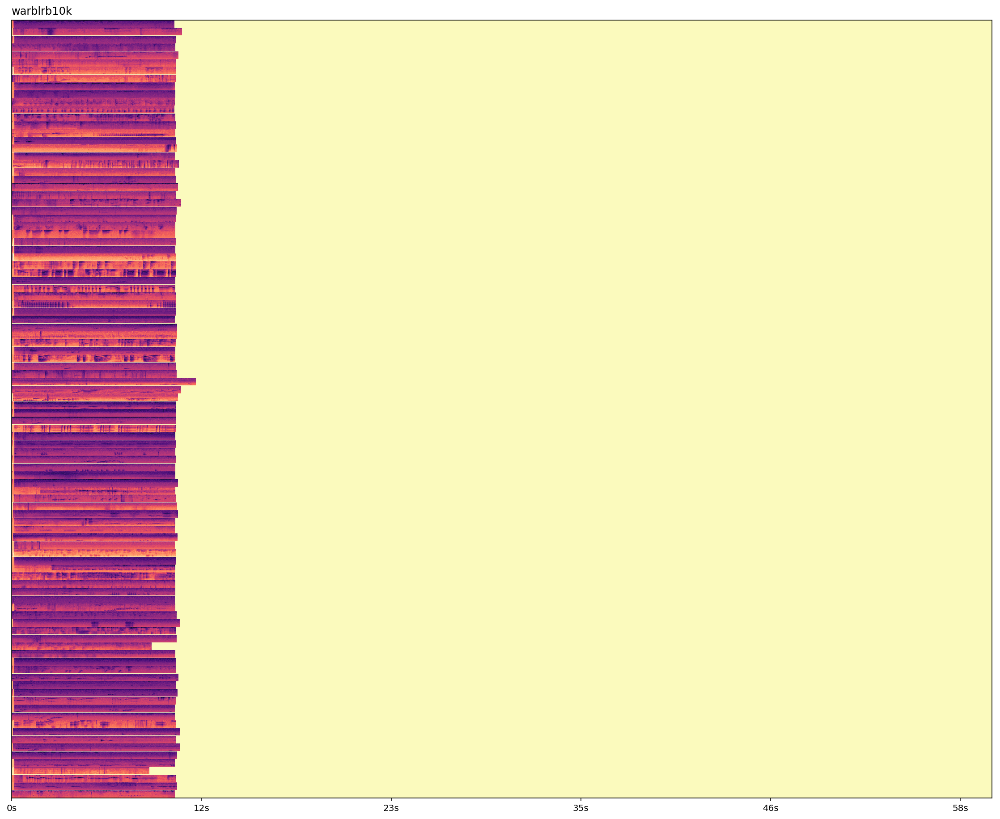

In [ ]:
with with_figsize('full'):
    plot_many_spectros(recs, "dataset == 'warblrb10k'")

(4100, 5168)

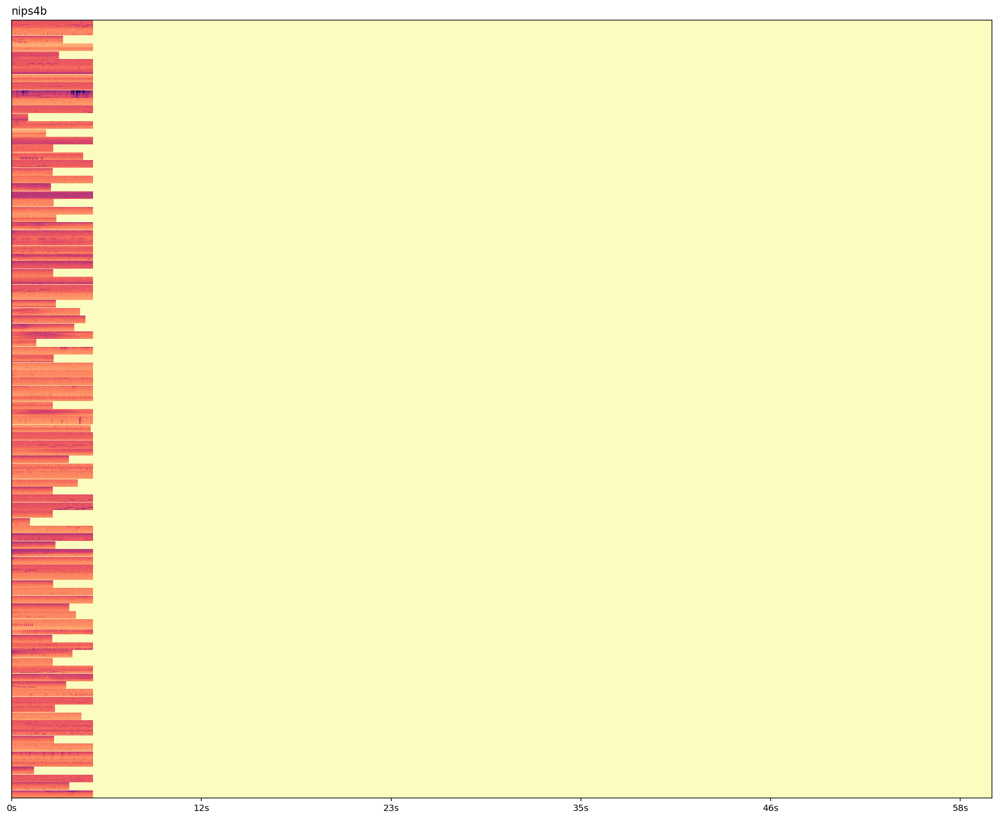

In [ ]:
with with_figsize('full'):
    plot_many_spectros(recs, "dataset == 'nips4b'")

(4100, 5168)

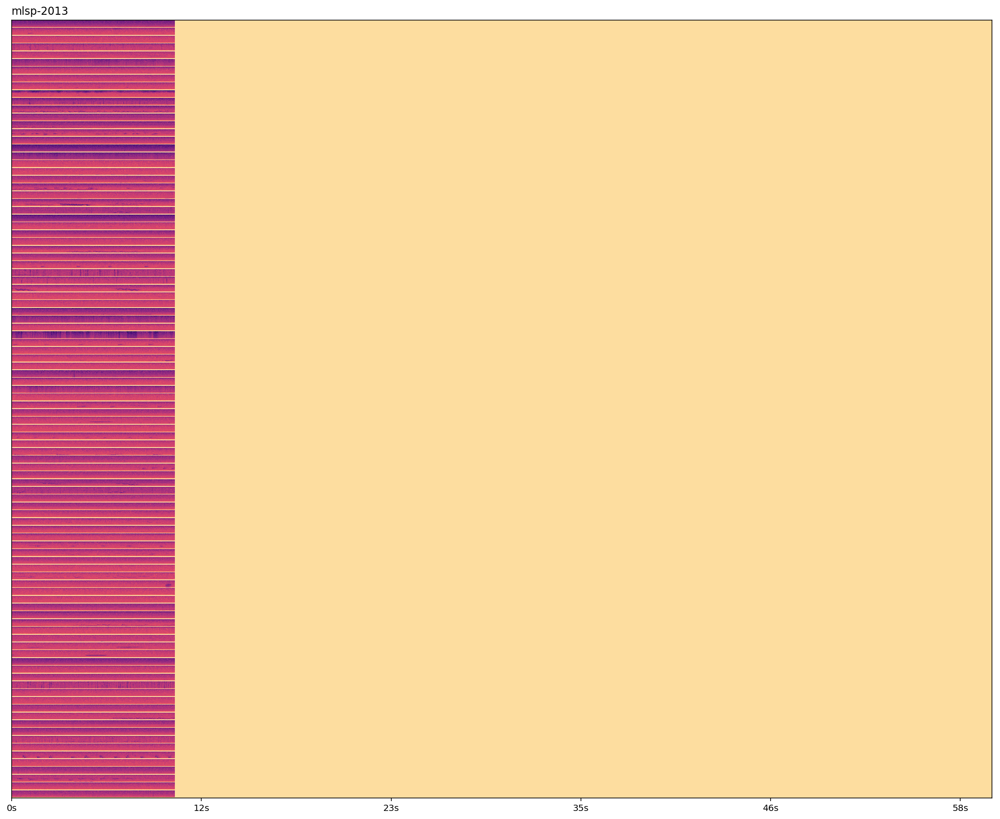

In [ ]:
with with_figsize('full'):
    plot_many_spectros(recs, "dataset == 'mlsp-2013'")

(4018, 5168)

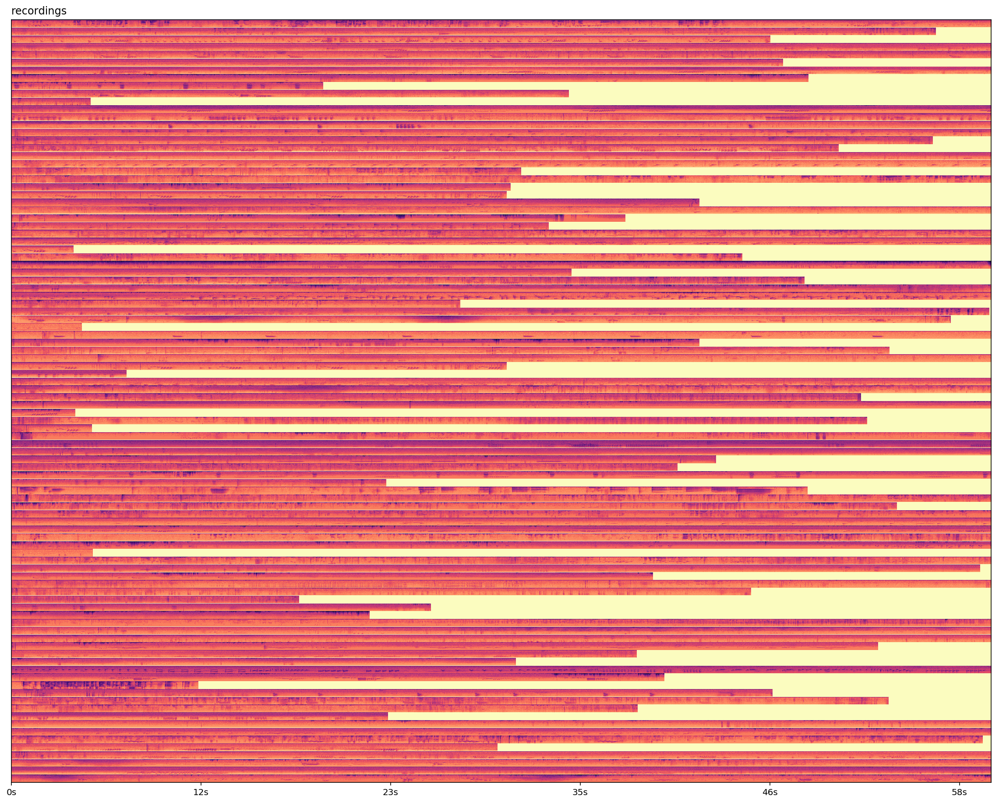

In [ ]:
with with_figsize('full'):
    plot_many_spectros(recs, "dataset == 'recordings'")